In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
sns.set_style('darkgrid')
sns.set_palette('Set2')

In [10]:
pd.set_option('display.max_columns', None)                          # Unfolding hidden features if the cardinality is high
pd.set_option('display.max_colwidth', None)                         # Unfolding the max feature width for better clearity
pd.set_option('display.max_rows', None)                             # Unfolding hidden data points if the cardinality is high
pd.set_option('mode.chained_assignment', None) 

In [11]:
df = pd.read_csv("clean data.csv")

# drop unnecessary columns from dataset
df.drop(columns=['Unnamed: 0','Front Brake Type','Gears','Mileage (ARAI)','Power_Windows','Four_Wheel_Drive',
                 'Air_Conditioner','Heater','Registration type','Steering Type'],axis=1,inplace=True)

#rename columns
df=df.rename(columns={'No. of Owner(s)':'Num_of_Owners'})

# convert to datetime and extract years
df['Year'] = pd.to_datetime(df['Year'],format="%Y")
df['year'] = df['Year'].dt.year

#precaution to make following fetures integers
df['Doors'] = df['Doors'].astype('int').astype('category')
df['Seating Capacity'] = df['Seating Capacity'].astype('int').astype('category')
df['No of Seating Rows'] = df['No of Seating Rows'].astype('int').astype('category')

#petrol and diesel only
df.loc[(df['Fuel Type']=='Petrol'),'Fuel Type'] = "Petrol+"
df.loc[(df['Fuel Type']=='CNG'),'Fuel Type'] = "Petrol+"
df.loc[(df['Fuel Type']=='LPG'),'Fuel Type'] = "Petrol+"
df.loc[(df['Fuel Type']=='Petrol + CNG'),'Fuel Type'] = "Petrol+"
df.loc[(df['Fuel Type']=='Petrol + LPG'),'Fuel Type'] = "Petrol+"
df.loc[(df['Fuel Type']=='Hybrid'),'Fuel Type'] = "Petrol+"

In [12]:
df.head()

,Price,Year,Kilometer,Fuel Type,Num_of_Owners,Insurance,Engine,Drivetrain,Turbocharger/Supercharger,Length,Width,Height,Wheelbase,Doors,Seating Capacity,No of Seating Rows,Rear Brake Type,Transmission_Type,Cruise_Control,ABS,Sunroof,Rear_Wiper,Steering_Adjustment,Parking_Sensors,Instrument_Cluster,Steering_controls,Display,Mileage,Power_bhp,Torque_Nm,year
0,2650000,2015-01-01,96000,Diesel,Second,Comprehensive,2967.0,AWD,Yes,5089,1983,1737,3002,5,7,3,Disc,Automatic,True,True,True,True,True,True,True,True,True,12.07,241.0,550.0,2015
1,560000,2018-01-01,44350,Petrol+,Second,Not Available,1197.0,FWD,No,3985,1734,1505,2570,5,5,2,Drum,Manual,False,False,False,False,False,False,True,False,False,18.60,82.0,115.0,2018
2,400000,2014-01-01,85000,Diesel,First,Third Party,1248.0,FWD,No,3995,1695,1555,2430,4,5,2,Drum,Manual,False,False,False,False,True,False,False,False,False,23.40,74.0,190.0,2014
3,1015000,2021-01-01,26982,Petrol+,First,Third Party,1462.0,FWD,No,3995,1790,1640,2500,5,5,2,Drum,Manual,True,True,False,True,True,True,True,True,True,17.00,103.0,138.0,2021
4,990000,2014-01-01,110700,Diesel,Second,Not Available,1968.0,FWD,Yes,4861,1864,1483,2841,4,5,2,Disc,Automatic,True,True,True,False,True,True,True,True,True,18.66,174.0,350.0,2014


In [13]:
print(df.info(verbose=True))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5324 entries, 0 to 5323
Data columns (total 31 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Price                      5324 non-null   int64         
 1   Year                       5324 non-null   datetime64[ns]
 2   Kilometer                  5324 non-null   int64         
 3   Fuel Type                  5324 non-null   object        
 4   Num_of_Owners              5324 non-null   object        
 5   Insurance                  5324 non-null   object        
 6   Engine                     5324 non-null   float64       
 7   Drivetrain                 5324 non-null   object        
 8   Turbocharger/Supercharger  5324 non-null   object        
 9   Length                     5324 non-null   int64         
 10  Width                      5324 non-null   int64         
 11  Height                     5324 non-null   int64         
 12  Wheelb

In [7]:
df.describe().columns

Index(['Price', 'Kilometer', 'Engine', 'Length', 'Width', 'Height',
       'Wheelbase', 'Mileage', 'Power_bhp', 'Torque_Nm', 'year'],
      dtype='object')

In [8]:
df.describe()

,Price,Kilometer,Engine,Length,Width,Height,Wheelbase,Mileage,Power_bhp,Torque_Nm,year
count,5.324000e+03,5.324000e+03,5324.000000,5324.000000,5324.000000,5324.000000,5324.000000,5324.000000,5324.000000,5324.000000,5324.000000
mean,1.239327e+06,8.637643e+05,1571.848798,4216.131104,1748.982156,1573.577385,2590.826446,18.848211,117.953794,220.392123,2016.499061
std,1.460682e+06,4.161732e+07,564.870050,423.100023,120.564429,121.943684,173.430955,4.093009,55.322396,126.697989,2.892234
min,0.000000e+00,0.000000e+00,624.000000,3099.000000,1410.000000,1281.000000,1840.000000,5.880000,29.000000,48.000000,2007.000000
25%,5.037500e+05,3.076600e+04,1197.000000,3971.000000,1695.000000,1485.000000,2450.000000,16.100000,82.000000,114.000000,2015.000000
50%,7.330000e+05,5.200000e+04,1462.000000,4270.000000,1735.000000,1530.000000,2570.000000,18.600000,100.000000,190.000000,2017.000000
75%,1.400000e+06,7.600000e+04,1968.000000,4500.000000,1820.000000,1640.000000,2699.000000,21.400000,141.000000,320.000000,2019.000000
max,3.350000e+07,2.147484e+09,6592.000000,5399.000000,2195.000000,1995.000000,3295.000000,33.540000,626.000000,820.000000,2022.000000


In [8]:
# function to plot box plot and histogram to understand outliers and distribution of data in that feature

def boxplot(i):
    fig,ax = plt.subplots(2,1,figsize=(16,3))
    sns.boxplot(df[i],ax=ax[0])
    sns.histplot(data = df,x=i,kde=True,ax=ax[1])
    fig.suptitle(i,size = 23)
    plt.show()

In [9]:
cols= df.describe().columns.tolist()
cols.remove('Kilometer')

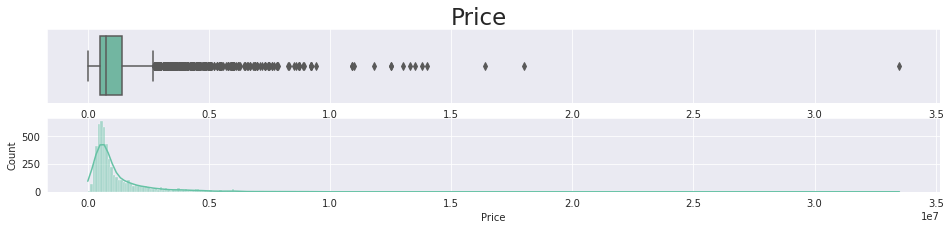

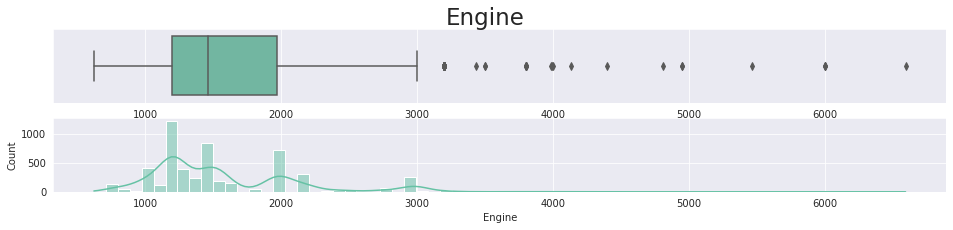

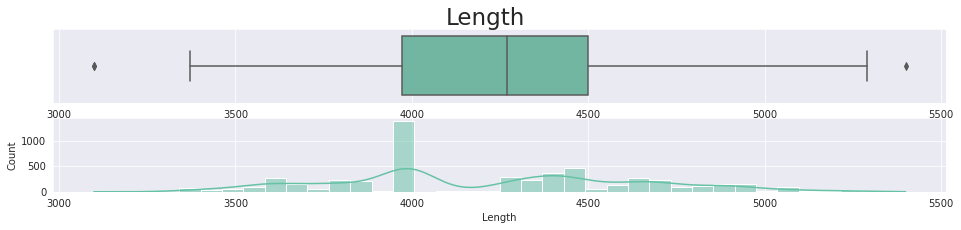

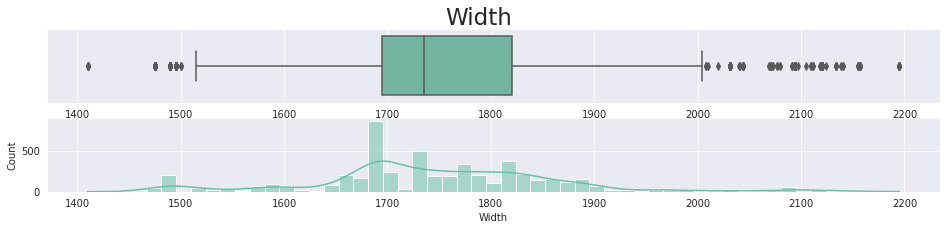

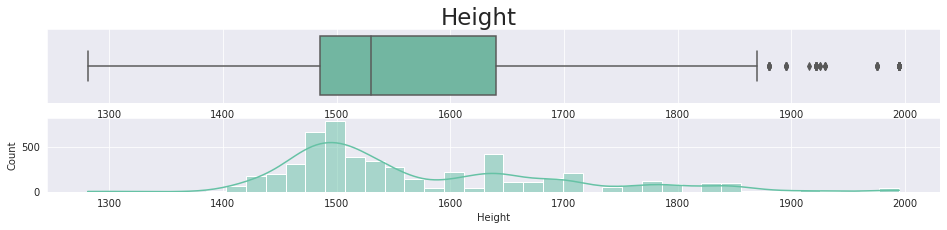

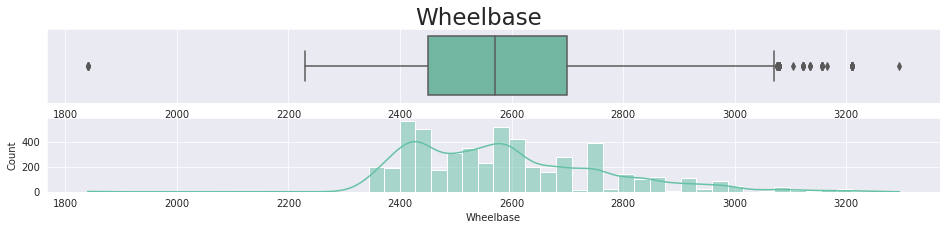

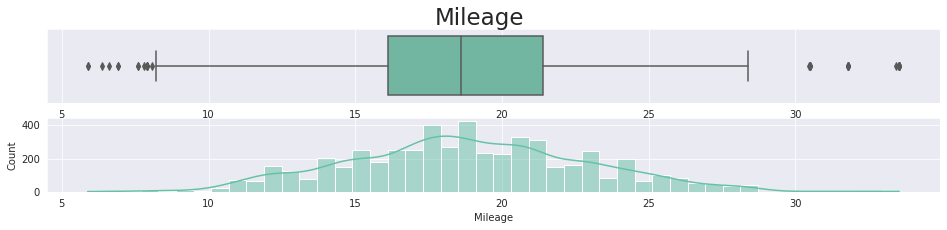

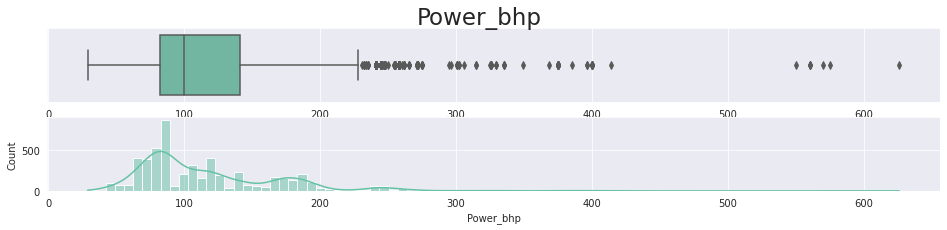

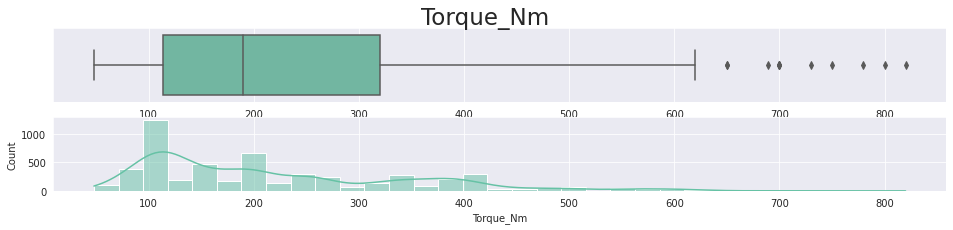

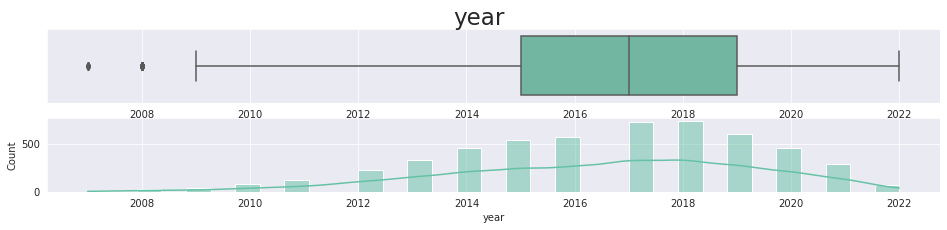

In [10]:
for i in cols:
    boxplot(i)

In [11]:
def barplot(i):
    fig,ax = plt.subplots(figsize=(10,3))
    sns.barplot(df[i].value_counts().index,df[i].value_counts().values)
    plt.title(i)
    plt.show()

In [12]:
cols = df.columns.tolist()  
for j in df.describe().columns.tolist():
    cols.remove(j)

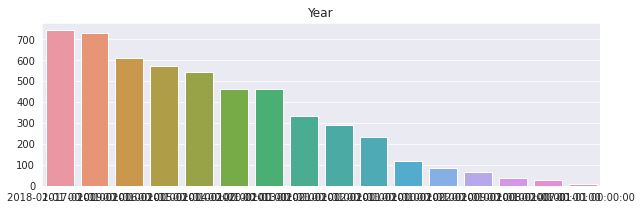

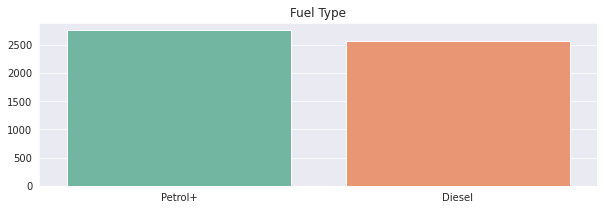

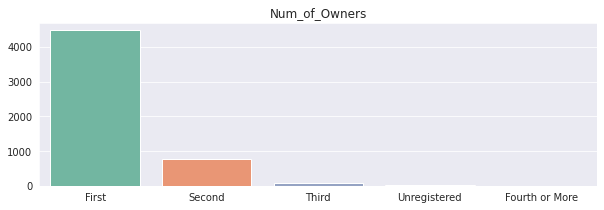

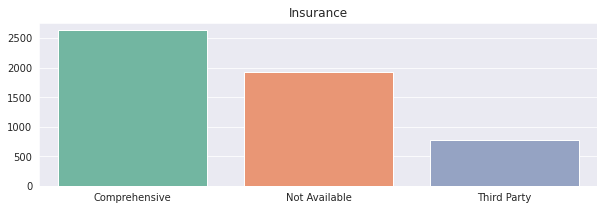

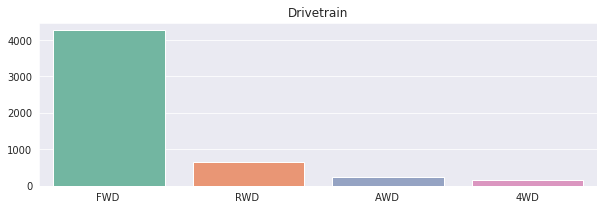

...

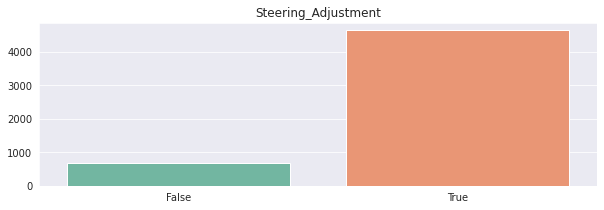

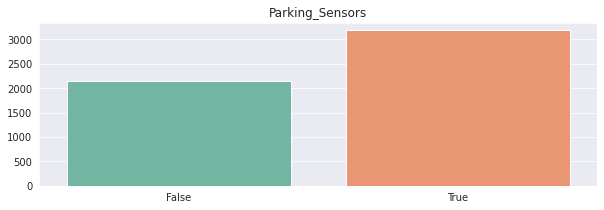

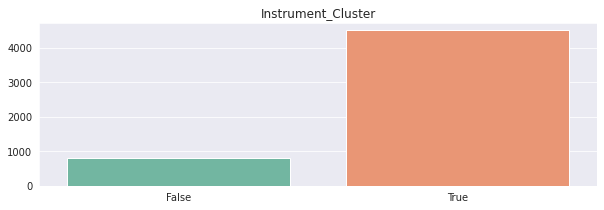

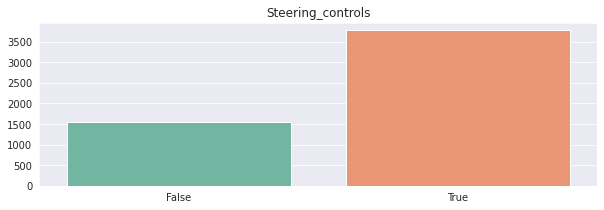

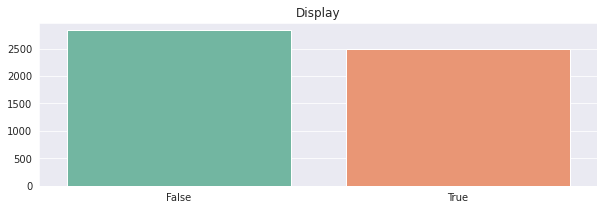

In [13]:
for i in cols:
    barplot(i)    

Columns to observe
`No. of Owner(s)`
`Doors`
`Seating Capacity`

### Number of owners

In [14]:
df['Num_of_Owners'].value_counts()

First             4468
Second             764
Third               74
Unregistered        14
Fourth or More       4
Name: Num_of_Owners, dtype: int64

In [15]:
df.loc[df['Num_of_Owners']=='Fourth or More','Num_of_Owners'] = 'Second'
df.loc[df['Num_of_Owners']=='Third','Num_of_Owners'] = 'Second'
df.loc[df['Num_of_Owners']=='Third+','Num_of_Owners'] = 'Second'
df.loc[df['Num_of_Owners']=='Second','Num_of_Owners'] = 'Second+'

In [16]:
df['Num_of_Owners'].value_counts()

First           4468
Second+          842
Unregistered      14
Name: Num_of_Owners, dtype: int64

### Doors

In [17]:
df['Doors'].value_counts()

5    3594
4    1683
2      39
3       8
Name: Doors, dtype: int64

In [18]:
df.loc[df['Doors']==3,'Doors'] = 2

In [19]:
df['Doors'] = df['Doors'].astype('int').astype('category')

### Seating Capacity

In [20]:
df['Seating Capacity'].value_counts()

5    4546
7     594
6      71
4      61
8      36
2      10
9       6
Name: Seating Capacity, dtype: int64

In [21]:
df.loc[(df['Seating Capacity']==8)&(df['Doors']==5),'Seating Capacity']=7
df.loc[(df['Seating Capacity']==9)&(df['Doors']==5),'Seating Capacity']=7

In [22]:
df['Doors'] = df['Doors'].astype('int').astype('category')
df['Seating Capacity'] = df['Seating Capacity'].astype('int').astype('category')
df['No of Seating Rows'] = df['No of Seating Rows'].astype('int').astype('category')

## Remove Outliers

In [23]:
# Using Z score remove outliers

mean = np.mean(df['Price'])
std = np.std(df['Price'])
z_score_positive = mean + 3*std
z_score_negative = mean - 3*std
z_score_positive,z_score_negative
df = df[(df['Price']<z_score_positive)&(df['Price']>z_score_negative)]

In [24]:
df.shape

(5215, 31)

In [25]:
df.describe()

,Price,Kilometer,Engine,Length,Width,Height,Wheelbase,Mileage,Power_bhp,Torque_Nm,year
count,5.215000e+03,5.215000e+03,5215.000000,5215.000000,5215.000000,5215.000000,5215.000000,5215.000000,5215.000000,5215.000000,5215.000000
mean,1.098332e+06,8.804290e+05,1546.837392,4201.283797,1744.885331,1573.569703,2583.565868,18.971341,114.548802,214.615084,2016.454458
std,9.818254e+05,4.204988e+07,526.273091,413.181956,117.493745,120.458626,164.995537,4.020000,48.760469,120.082727,2.878599
min,0.000000e+00,0.000000e+00,624.000000,3099.000000,1410.000000,1291.000000,1840.000000,5.880000,29.000000,48.000000,2007.000000
25%,5.000000e+05,3.181550e+04,1197.000000,3971.000000,1694.000000,1485.000000,2450.000000,16.470000,82.000000,114.000000,2015.000000
50%,7.250000e+05,5.253000e+04,1461.000000,4223.000000,1735.000000,1530.000000,2570.000000,18.700000,99.000000,190.000000,2017.000000
75%,1.300000e+06,7.600000e+04,1956.000000,4490.000000,1817.000000,1640.000000,2680.000000,21.400000,140.000000,290.000000,2019.000000
max,5.590000e+06,2.147484e+09,5998.000000,5290.000000,2195.000000,1995.000000,3210.000000,33.540000,560.000000,650.000000,2022.000000


## scale the data

In [26]:
from scipy.stats import skew

In [27]:
for i in df.describe().columns:
    print(i,skew(df[i]))

Price 2.0816260176907257
Kilometer 51.03422506922354
Engine 1.3863487455564478
Length 0.14944981174194383
Width 0.32469834579973
Height 1.1853027664690763
Wheelbase 0.6991413731800542
Mileage 0.16813407877472494
Power_bhp 1.465566826832587
Torque_Nm 1.0026715750781996
year -0.45898227129849517


In [28]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from scipy import stats

In [29]:
scaler = MinMaxScaler(feature_range=(0,2))

In [30]:
ls = df.describe().columns.tolist()
ls = ls[2:]
ls

['Engine',
 'Length',
 'Width',
 'Height',
 'Wheelbase',
 'Mileage',
 'Power_bhp',
 'Torque_Nm',
 'year']

In [31]:
for i in ls:
    df[i] = np.log(df[i],dtype=np.float64)

In [32]:
data = pd.DataFrame(data = df[ls],columns=ls)

In [33]:
data.head()

,Engine,Length,Width,Height,Wheelbase,Mileage,Power_bhp,Torque_Nm,year
0,7.995307,8.534837,7.592366,7.459915,8.007034,2.490723,5.484797,6.309918,7.608374
1,7.087574,8.290293,7.458186,7.316548,7.851661,2.923162,4.406719,4.744932,7.609862
2,7.129298,8.292799,7.435438,7.349231,7.795647,3.152736,4.304065,5.247024,7.607878
3,7.287561,8.292799,7.489971,7.402452,7.824046,2.833213,4.634729,4.927254,7.611348
4,7.584773,8.488999,7.530480,7.301822,7.951911,2.926382,5.159055,5.857933,7.607878


In [34]:
df[ls] = data[ls]

In [35]:
df.head()

,Price,Year,Kilometer,Fuel Type,Num_of_Owners,Insurance,Engine,Drivetrain,Turbocharger/Supercharger,Length,Width,Height,Wheelbase,Doors,Seating Capacity,No of Seating Rows,Rear Brake Type,Transmission_Type,Cruise_Control,ABS,Sunroof,Rear_Wiper,Steering_Adjustment,Parking_Sensors,Instrument_Cluster,Steering_controls,Display,Mileage,Power_bhp,Torque_Nm,year
0,2650000,2015-01-01,96000,Diesel,Second+,Comprehensive,7.995307,AWD,Yes,8.534837,7.592366,7.459915,8.007034,5,7,3,Disc,Automatic,True,True,True,True,True,True,True,True,True,2.490723,5.484797,6.309918,7.608374
1,560000,2018-01-01,44350,Petrol+,Second+,Not Available,7.087574,FWD,No,8.290293,7.458186,7.316548,7.851661,5,5,2,Drum,Manual,False,False,False,False,False,False,True,False,False,2.923162,4.406719,4.744932,7.609862
2,400000,2014-01-01,85000,Diesel,First,Third Party,7.129298,FWD,No,8.292799,7.435438,7.349231,7.795647,4,5,2,Drum,Manual,False,False,False,False,True,False,False,False,False,3.152736,4.304065,5.247024,7.607878
3,1015000,2021-01-01,26982,Petrol+,First,Third Party,7.287561,FWD,No,8.292799,7.489971,7.402452,7.824046,5,5,2,Drum,Manual,True,True,False,True,True,True,True,True,True,2.833213,4.634729,4.927254,7.611348
4,990000,2014-01-01,110700,Diesel,Second+,Not Available,7.584773,FWD,Yes,8.488999,7.530480,7.301822,7.951911,4,5,2,Disc,Automatic,True,True,True,False,True,True,True,True,True,2.926382,5.159055,5.857933,7.607878


In [36]:
df.columns

Index(['Price', 'Year', 'Kilometer', 'Fuel Type', 'Num_of_Owners', 'Insurance',
       'Engine', 'Drivetrain', 'Turbocharger/Supercharger', 'Length', 'Width',
       'Height', 'Wheelbase', 'Doors', 'Seating Capacity',
       'No of Seating Rows', 'Rear Brake Type', 'Transmission_Type',
       'Cruise_Control', 'ABS', 'Sunroof', 'Rear_Wiper', 'Steering_Adjustment',
       'Parking_Sensors', 'Instrument_Cluster', 'Steering_controls', 'Display',
       'Mileage', 'Power_bhp', 'Torque_Nm', 'year'],
      dtype='object')

In [37]:
df = df.rename(columns={"Kilometer":"Runnig_km","Fuel Type":"Fuel","Num_of_Owners":"Owners","Turbocharger/Supercharger":"Turbo",
       "Seating Capacity":"Seats","No of Seating Rows":"Seat_rows","Display":"Infotainment_screen"})

In [38]:
df.columns

Index(['Price', 'Year', 'Runnig_km', 'Fuel', 'Owners', 'Insurance', 'Engine',
       'Drivetrain', 'Turbo', 'Length', 'Width', 'Height', 'Wheelbase',
       'Doors', 'Seats', 'Seat_rows', 'Rear Brake Type', 'Transmission_Type',
       'Cruise_Control', 'ABS', 'Sunroof', 'Rear_Wiper', 'Steering_Adjustment',
       'Parking_Sensors', 'Instrument_Cluster', 'Steering_controls',
       'Infotainment_screen', 'Mileage', 'Power_bhp', 'Torque_Nm', 'year'],
      dtype='object')

In [39]:
df.drop(columns=['Drivetrain','Length','Width','Height','Wheelbase','Doors','Seats','Steering_Adjustment','Instrument_Cluster','Power_bhp','Torque_Nm'],axis=1,inplace=True)

In [40]:
df.columns

Index(['Price', 'Year', 'Runnig_km', 'Fuel', 'Owners', 'Insurance', 'Engine',
       'Turbo', 'Seat_rows', 'Rear Brake Type', 'Transmission_Type',
       'Cruise_Control', 'ABS', 'Sunroof', 'Rear_Wiper', 'Parking_Sensors',
       'Steering_controls', 'Infotainment_screen', 'Mileage', 'year'],
      dtype='object')

In [41]:
to_drop_idx = df[df['Price']==0].index
df.drop(to_drop_idx, inplace=True)
df = df[df['Runnig_km']<500000]

In [42]:
df.reset_index(inplace=True,drop=True)

## Price

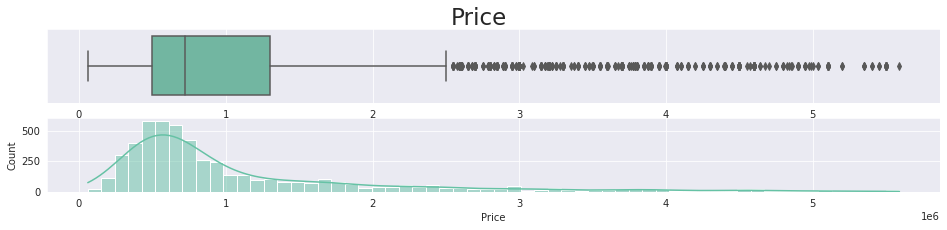

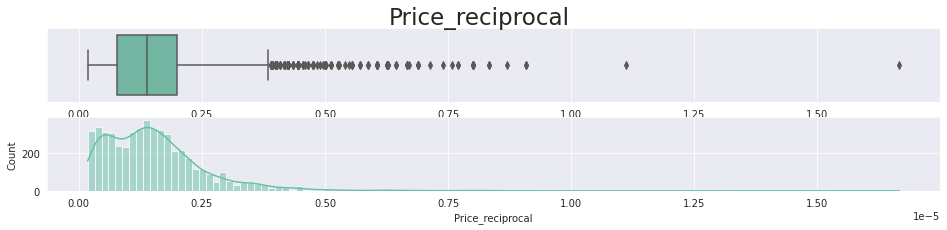

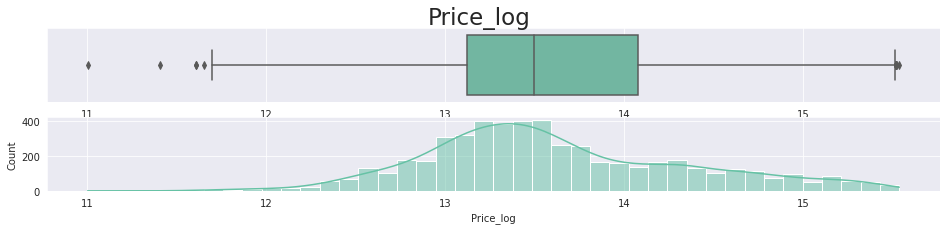

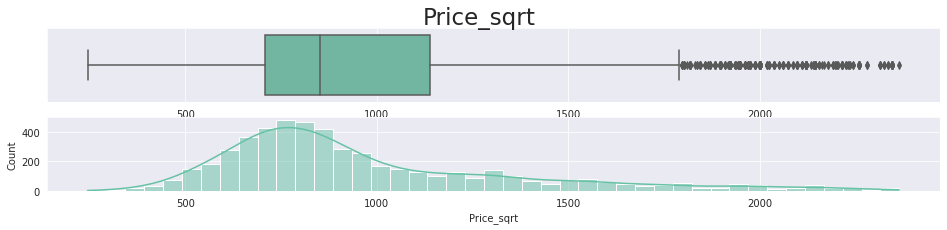

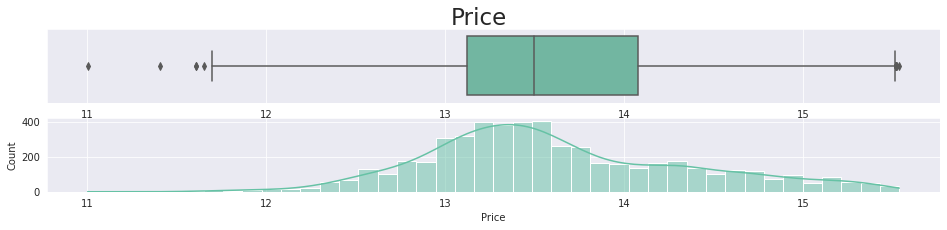

In [43]:
df['Price_reciprocal'] = 1/df['Price']
df['Price_log'] = np.log(df['Price'])
df['Price_sqrt'] = np.sqrt(df['Price'])
#

boxplot('Price')
boxplot('Price_reciprocal')
boxplot('Price_log')
boxplot('Price_sqrt')

df.drop(columns=['Price_reciprocal','Price_log','Price_sqrt'])
df['Price'] = np.log(df['Price'])
boxplot('Price')

## Running KM

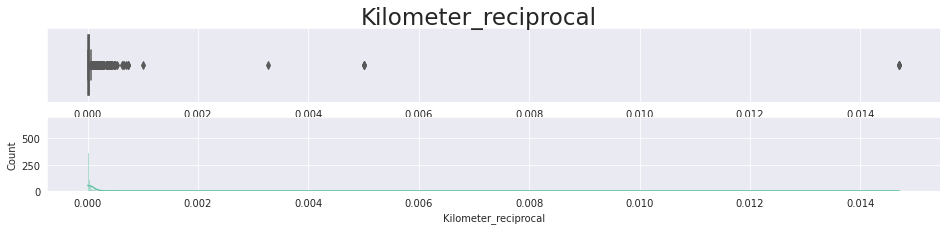

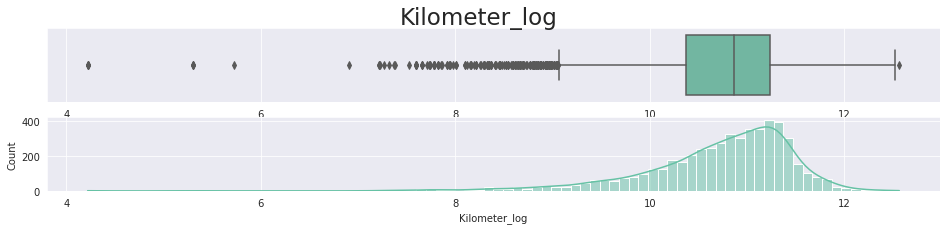

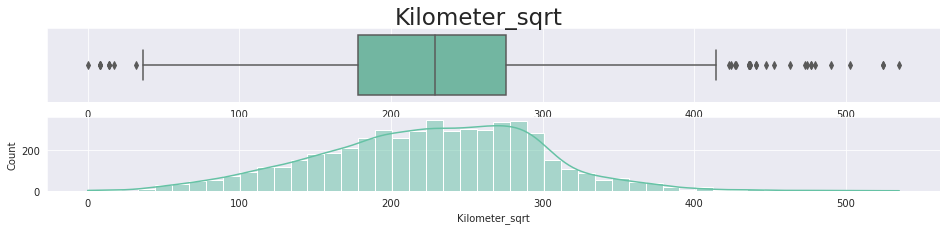

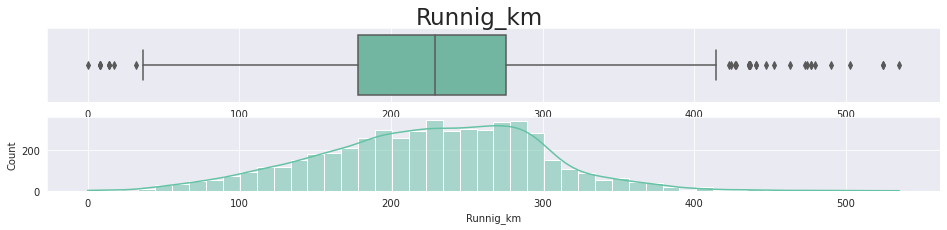

In [44]:
df['Kilometer_reciprocal'] = 1/df['Runnig_km']
df['Kilometer_log'] = np.log(df['Runnig_km'])
df['Kilometer_sqrt'] = np.sqrt(df['Runnig_km'])
#

#boxplot('Kilometer')
boxplot('Kilometer_reciprocal')
boxplot('Kilometer_log')
boxplot('Kilometer_sqrt')

df.drop(columns=['Kilometer_reciprocal','Kilometer_log','Kilometer_sqrt'])
df['Runnig_km'] = np.sqrt(df['Runnig_km'])
boxplot('Runnig_km')

In [45]:
def scale(x):
  min = 1
  max = 600
  out = (x - min)/(max-min)
  return out

df['Runnig_km'] = df['Runnig_km'].apply(scale)

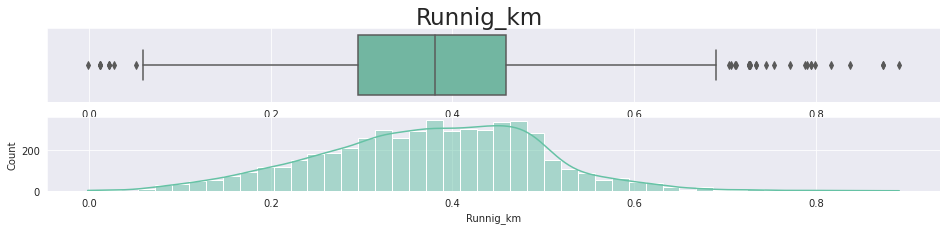

In [46]:
boxplot('Runnig_km')

## Engine CC

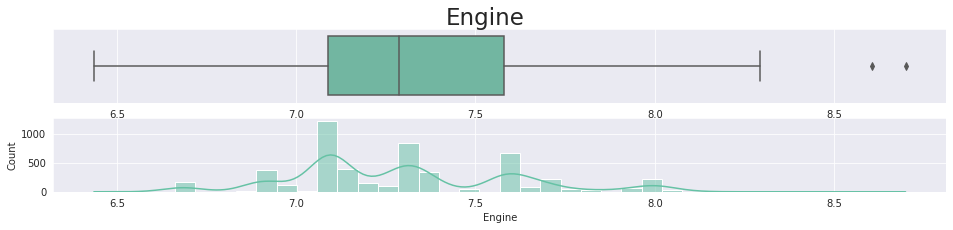

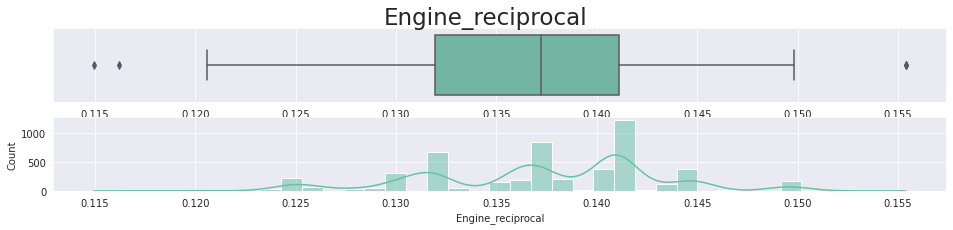

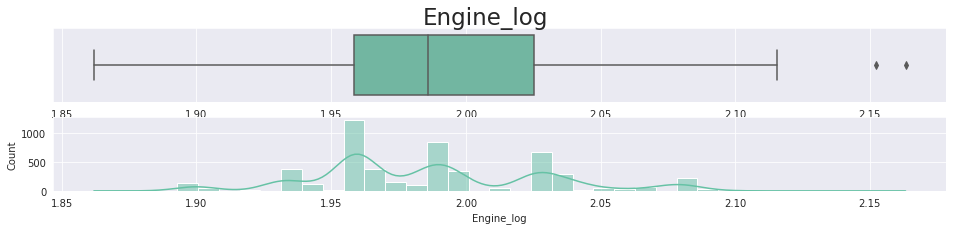

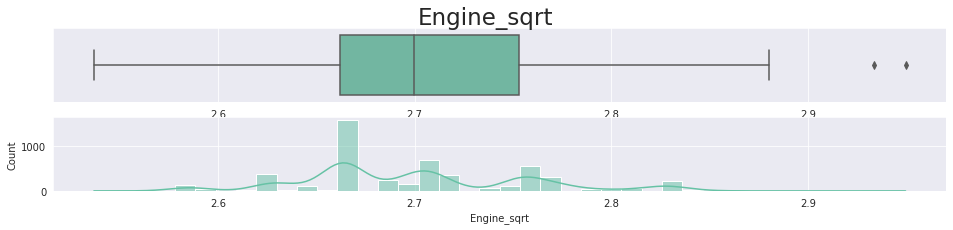

,Price,Year,Runnig_km,Fuel,Owners,Insurance,Engine,Turbo,Seat_rows,Rear Brake Type,Transmission_Type,Cruise_Control,ABS,Sunroof,Rear_Wiper,Parking_Sensors,Steering_controls,Infotainment_screen,Mileage,year,Price_reciprocal,Price_log,Price_sqrt,Kilometer_reciprocal,Kilometer_log,Kilometer_sqrt
0,14.790070,2015-01-01,0.515590,Diesel,Second+,Comprehensive,7.995307,Yes,3,Disc,Automatic,True,True,True,True,True,True,True,2.490723,7.608374,3.773585e-07,14.790070,1627.882060,0.000010,11.472103,309.838668
1,13.235692,2018-01-01,0.349907,Petrol+,Second+,Not Available,7.087574,No,2,Drum,Manual,False,False,False,False,False,False,False,2.923162,7.609862,1.785714e-06,13.235692,748.331477,0.000023,10.699868,210.594397
2,12.899220,2014-01-01,0.485054,Diesel,First,Third Party,7.129298,No,2,Drum,Manual,False,False,False,False,False,False,False,3.152736,7.607878,2.500000e-06,12.899220,632.455532,0.000012,11.350407,291.547595
3,13.830399,2021-01-01,0.272558,Petrol+,First,Third Party,7.287561,No,2,Drum,Manual,True,True,False,True,True,True,True,2.833213,7.611348,9.852217e-07,13.830399,1007.472084,0.000037,10.202925,164.261986
4,13.805460,2014-01-01,0.553783,Diesel,Second+,Not Available,7.584773,Yes,2,Disc,Automatic,True,True,True,False,True,True,True,2.926382,7.607878,1.010101e-06,13.805460,994.987437,0.000009,11.614579,332.716095
5,12.506177,2017-01-01,0.319455,Petrol+,First,Not Available,6.683361,No,2,Drum,Manual,False,True,False,False,False,False,True,3.225653,7.609367,3.703704e-06,12.506177,519.615242,0.000027,10.518673,192.353841
6,12.847927,2014-01-01,0.420671,Petrol+,First,Comprehensive,7.087574,No,2,Drum,Manual,False,True,False,False,True,True,False,2.949688,7.607878,2.631579e-06,12.847927,616.441400,0.000016,11.066638,252.982213
7,13.864301,2020-01-01,0.418438,Diesel,First,Comprehensive,7.311218,Yes,2,Disc,Manual,True,True,True,True,True,True,True,2.995732,7.610853,9.523810e-07,13.864301,1024.695077,0.000016,11.056035,251.644591
8,13.623139,2019-01-01,0.341746,Diesel,First,Comprehensive,7.311886,Yes,2,Drum,Manual,False,True,True,True,True,True,True,3.077312,7.610358,1.212121e-06,13.623139,908.295106,0.000024,10.652897,205.706101
9,13.567049,2019-01-01,0.414777,Diesel,First,Comprehensive,7.311886,Yes,2,Drum,Manual,False,True,False,True,True,True,True,3.135494,7.610358,1.282051e-06,13.567049,883.176087,0.000016,11.038528,249.451398


In [47]:
df['Engine_reciprocal'] = 1/df['Engine']
df['Engine_log'] = np.log(df['Engine'])
df['Engine_sqrt'] = np.sqrt(df['Engine'])
#

boxplot('Engine')
boxplot('Engine_reciprocal')
boxplot('Engine_log')
boxplot('Engine_sqrt')

df.drop(columns=['Engine_reciprocal','Engine_log','Engine_sqrt'])

## Mileage

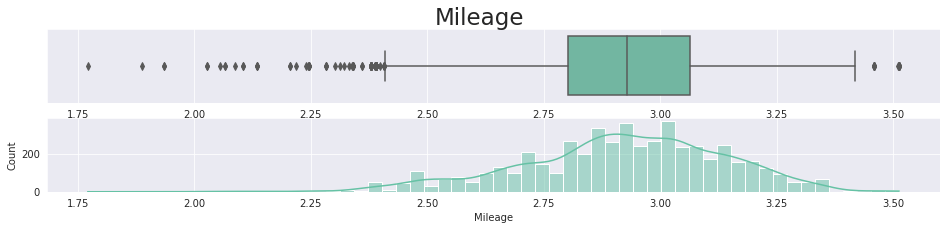

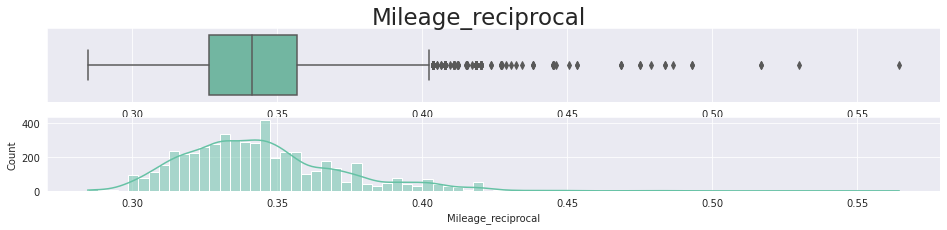

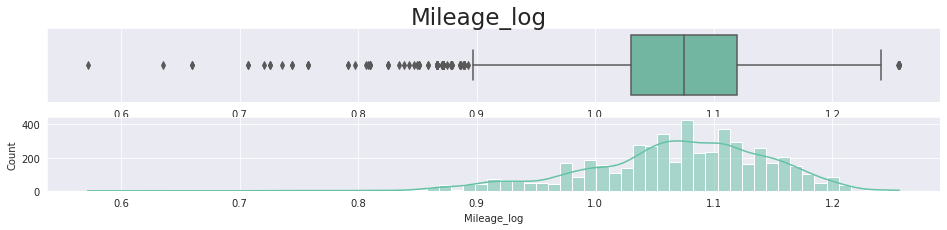

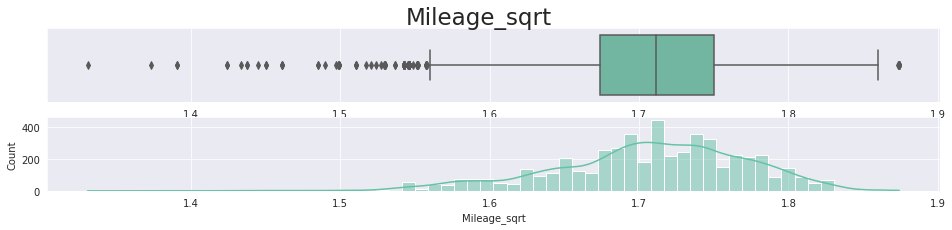

,Price,Year,Runnig_km,Fuel,Owners,Insurance,Engine,Turbo,Seat_rows,Rear Brake Type,Transmission_Type,Cruise_Control,ABS,Sunroof,Rear_Wiper,Parking_Sensors,Steering_controls,Infotainment_screen,Mileage,year,Price_reciprocal,Price_log,Price_sqrt,Kilometer_reciprocal,Kilometer_log,Kilometer_sqrt,Engine_reciprocal,Engine_log,Engine_sqrt
0,14.790070,2015-01-01,0.515590,Diesel,Second+,Comprehensive,7.995307,Yes,3,Disc,Automatic,True,True,True,True,True,True,True,2.490723,7.608374,3.773585e-07,14.790070,1627.882060,0.000010,11.472103,309.838668,0.125073,2.078855,2.827597
1,13.235692,2018-01-01,0.349907,Petrol+,Second+,Not Available,7.087574,No,2,Drum,Manual,False,False,False,False,False,False,False,2.923162,7.609862,1.785714e-06,13.235692,748.331477,0.000023,10.699868,210.594397,0.141092,1.958343,2.662250
2,12.899220,2014-01-01,0.485054,Diesel,First,Third Party,7.129298,No,2,Drum,Manual,False,False,False,False,False,False,False,3.152736,7.607878,2.500000e-06,12.899220,632.455532,0.000012,11.350407,291.547595,0.140266,1.964213,2.670074
3,13.830399,2021-01-01,0.272558,Petrol+,First,Third Party,7.287561,No,2,Drum,Manual,True,True,False,True,True,True,True,2.833213,7.611348,9.852217e-07,13.830399,1007.472084,0.000037,10.202925,164.261986,0.137220,1.986169,2.699548
4,13.805460,2014-01-01,0.553783,Diesel,Second+,Not Available,7.584773,Yes,2,Disc,Automatic,True,True,True,False,True,True,True,2.926382,7.607878,1.010101e-06,13.805460,994.987437,0.000009,11.614579,332.716095,0.131843,2.026143,2.754047
5,12.506177,2017-01-01,0.319455,Petrol+,First,Not Available,6.683361,No,2,Drum,Manual,False,True,False,False,False,False,True,3.225653,7.609367,3.703704e-06,12.506177,519.615242,0.000027,10.518673,192.353841,0.149625,1.899621,2.585220
6,12.847927,2014-01-01,0.420671,Petrol+,First,Comprehensive,7.087574,No,2,Drum,Manual,False,True,False,False,True,True,False,2.949688,7.607878,2.631579e-06,12.847927,616.441400,0.000016,11.066638,252.982213,0.141092,1.958343,2.662250
7,13.864301,2020-01-01,0.418438,Diesel,First,Comprehensive,7.311218,Yes,2,Disc,Manual,True,True,True,True,True,True,True,2.995732,7.610853,9.523810e-07,13.864301,1024.695077,0.000016,11.056035,251.644591,0.136776,1.989410,2.703926
8,13.623139,2019-01-01,0.341746,Diesel,First,Comprehensive,7.311886,Yes,2,Drum,Manual,False,True,True,True,True,True,True,3.077312,7.610358,1.212121e-06,13.623139,908.295106,0.000024,10.652897,205.706101,0.136764,1.989501,2.704050
9,13.567049,2019-01-01,0.414777,Diesel,First,Comprehensive,7.311886,Yes,2,Drum,Manual,False,True,False,True,True,True,True,3.135494,7.610358,1.282051e-06,13.567049,883.176087,0.000016,11.038528,249.451398,0.136764,1.989501,2.704050


In [48]:
df['Mileage_reciprocal'] = 1/df['Mileage']
df['Mileage_log'] = np.log(df['Mileage'])
df['Mileage_sqrt'] = np.sqrt(df['Mileage'])
#

boxplot('Mileage')
boxplot('Mileage_reciprocal')
boxplot('Mileage_log')
boxplot('Mileage_sqrt')

df.drop(columns=['Mileage_reciprocal','Mileage_log','Mileage_sqrt'])

In [49]:
df.head()

,Price,Year,Runnig_km,Fuel,Owners,Insurance,Engine,Turbo,Seat_rows,Rear Brake Type,Transmission_Type,Cruise_Control,ABS,Sunroof,Rear_Wiper,Parking_Sensors,Steering_controls,Infotainment_screen,Mileage,year,Price_reciprocal,Price_log,Price_sqrt,Kilometer_reciprocal,Kilometer_log,Kilometer_sqrt,Engine_reciprocal,Engine_log,Engine_sqrt,Mileage_reciprocal,Mileage_log,Mileage_sqrt
0,14.790070,2015-01-01,0.515590,Diesel,Second+,Comprehensive,7.995307,Yes,3,Disc,Automatic,True,True,True,True,True,True,True,2.490723,7.608374,3.773585e-07,14.790070,1627.882060,0.000010,11.472103,309.838668,0.125073,2.078855,2.827597,0.401490,0.912573,1.578202
1,13.235692,2018-01-01,0.349907,Petrol+,Second+,Not Available,7.087574,No,2,Drum,Manual,False,False,False,False,False,False,False,2.923162,7.609862,1.785714e-06,13.235692,748.331477,0.000023,10.699868,210.594397,0.141092,1.958343,2.662250,0.342095,1.072666,1.709726
2,12.899220,2014-01-01,0.485054,Diesel,First,Third Party,7.129298,No,2,Drum,Manual,False,False,False,False,False,False,False,3.152736,7.607878,2.500000e-06,12.899220,632.455532,0.000012,11.350407,291.547595,0.140266,1.964213,2.670074,0.317185,1.148271,1.775595
3,13.830399,2021-01-01,0.272558,Petrol+,First,Third Party,7.287561,No,2,Drum,Manual,True,True,False,True,True,True,True,2.833213,7.611348,9.852217e-07,13.830399,1007.472084,0.000037,10.202925,164.261986,0.137220,1.986169,2.699548,0.352956,1.041412,1.683215
4,13.805460,2014-01-01,0.553783,Diesel,Second+,Not Available,7.584773,Yes,2,Disc,Automatic,True,True,True,False,True,True,True,2.926382,7.607878,1.010101e-06,13.805460,994.987437,0.000009,11.614579,332.716095,0.131843,2.026143,2.754047,0.341719,1.073767,1.710667


In [50]:
obj_cols = []
for i in df.columns.tolist():
    if df[i].dtype=='O':
        obj_cols.append(i)

In [51]:
df_one_hot = pd.get_dummies(df)

In [52]:
df_one_hot.drop(columns=['Price_reciprocal','Price_log','Price_sqrt'],axis=1,inplace=True)
df_one_hot.drop(columns=['Kilometer_reciprocal','Kilometer_log','Kilometer_sqrt'],axis=1,inplace=True)
df_one_hot.drop(columns=['Engine_reciprocal','Engine_log','Engine_sqrt'],axis=1,inplace=True)
df_one_hot.drop(columns=['Mileage_reciprocal','Mileage_log','Mileage_sqrt'],axis=1,inplace=True)
df_one_hot.head()

,Price,Year,Runnig_km,Engine,Cruise_Control,ABS,Sunroof,Rear_Wiper,Parking_Sensors,Steering_controls,Infotainment_screen,Mileage,year,Fuel_Diesel,Fuel_Petrol+,Owners_First,Owners_Second+,Owners_Unregistered,Insurance_Comprehensive,Insurance_Not Available,Insurance_Third Party,Turbo_No,Turbo_Yes,Seat_rows_1,Seat_rows_2,Seat_rows_3,Rear Brake Type_Disc,Rear Brake Type_Drum,Transmission_Type_Automatic,Transmission_Type_Manual
0,14.790070,2015-01-01,0.515590,7.995307,True,True,True,True,True,True,True,2.490723,7.608374,1,0,0,1,0,1,0,0,0,1,0,0,1,1,0,1,0
1,13.235692,2018-01-01,0.349907,7.087574,False,False,False,False,False,False,False,2.923162,7.609862,0,1,0,1,0,0,1,0,1,0,0,1,0,0,1,0,1
2,12.899220,2014-01-01,0.485054,7.129298,False,False,False,False,False,False,False,3.152736,7.607878,1,0,1,0,0,0,0,1,1,0,0,1,0,0,1,0,1
3,13.830399,2021-01-01,0.272558,7.287561,True,True,False,True,True,True,True,2.833213,7.611348,0,1,1,0,0,0,0,1,1,0,0,1,0,0,1,0,1
4,13.805460,2014-01-01,0.553783,7.584773,True,True,True,False,True,True,True,2.926382,7.607878,1,0,0,1,0,0,1,0,0,1,0,1,0,1,0,1,0


In [53]:
train_enc_cols = df_one_hot.columns.tolist()[2:]

In [54]:
import joblib
obj_file = './columns.pkl'
joblib.dump(value=train_enc_cols, filename=obj_file)

['./columns.pkl']

In [55]:
df_one_hot.drop(columns=['Year'],inplace=True)

In [56]:
df_one_hot.head()

,Price,Runnig_km,Engine,Cruise_Control,ABS,Sunroof,Rear_Wiper,Parking_Sensors,Steering_controls,Infotainment_screen,Mileage,year,Fuel_Diesel,Fuel_Petrol+,Owners_First,Owners_Second+,Owners_Unregistered,Insurance_Comprehensive,Insurance_Not Available,Insurance_Third Party,Turbo_No,Turbo_Yes,Seat_rows_1,Seat_rows_2,Seat_rows_3,Rear Brake Type_Disc,Rear Brake Type_Drum,Transmission_Type_Automatic,Transmission_Type_Manual
0,14.790070,0.515590,7.995307,True,True,True,True,True,True,True,2.490723,7.608374,1,0,0,1,0,1,0,0,0,1,0,0,1,1,0,1,0
1,13.235692,0.349907,7.087574,False,False,False,False,False,False,False,2.923162,7.609862,0,1,0,1,0,0,1,0,1,0,0,1,0,0,1,0,1
2,12.899220,0.485054,7.129298,False,False,False,False,False,False,False,3.152736,7.607878,1,0,1,0,0,0,0,1,1,0,0,1,0,0,1,0,1
3,13.830399,0.272558,7.287561,True,True,False,True,True,True,True,2.833213,7.611348,0,1,1,0,0,0,0,1,1,0,0,1,0,0,1,0,1
4,13.805460,0.553783,7.584773,True,True,True,False,True,True,True,2.926382,7.607878,1,0,0,1,0,0,1,0,0,1,0,1,0,1,0,1,0


In [57]:
df_one_hot['Cruise_Control'] = np.where(df_one_hot['Cruise_Control']==True,1,0)
df_one_hot['ABS'] = np.where(df_one_hot['ABS']==True,1,0)
df_one_hot['Sunroof'] = np.where(df_one_hot['Sunroof']==True,1,0)
df_one_hot['Rear_Wiper'] = np.where(df_one_hot['Rear_Wiper']==True,1,0)
df_one_hot['Parking_Sensors'] = np.where(df_one_hot['Parking_Sensors']==True,1,0)
df_one_hot['Steering_controls'] = np.where(df_one_hot['Steering_controls']==True,1,0)
df_one_hot['Infotainment_screen'] = np.where(df_one_hot['Infotainment_screen']==True,1,0)

In [58]:
df_one_hot.head()

,Price,Runnig_km,Engine,Cruise_Control,ABS,Sunroof,Rear_Wiper,Parking_Sensors,Steering_controls,Infotainment_screen,Mileage,year,Fuel_Diesel,Fuel_Petrol+,Owners_First,Owners_Second+,Owners_Unregistered,Insurance_Comprehensive,Insurance_Not Available,Insurance_Third Party,Turbo_No,Turbo_Yes,Seat_rows_1,Seat_rows_2,Seat_rows_3,Rear Brake Type_Disc,Rear Brake Type_Drum,Transmission_Type_Automatic,Transmission_Type_Manual
0,14.790070,0.515590,7.995307,1,1,1,1,1,1,1,2.490723,7.608374,1,0,0,1,0,1,0,0,0,1,0,0,1,1,0,1,0
1,13.235692,0.349907,7.087574,0,0,0,0,0,0,0,2.923162,7.609862,0,1,0,1,0,0,1,0,1,0,0,1,0,0,1,0,1
2,12.899220,0.485054,7.129298,0,0,0,0,0,0,0,3.152736,7.607878,1,0,1,0,0,0,0,1,1,0,0,1,0,0,1,0,1
3,13.830399,0.272558,7.287561,1,1,0,1,1,1,1,2.833213,7.611348,0,1,1,0,0,0,0,1,1,0,0,1,0,0,1,0,1
4,13.805460,0.553783,7.584773,1,1,1,0,1,1,1,2.926382,7.607878,1,0,0,1,0,0,1,0,0,1,0,1,0,1,0,1,0


In [59]:
#df_one_hot.to_csv('Ready_for_ML.csv')

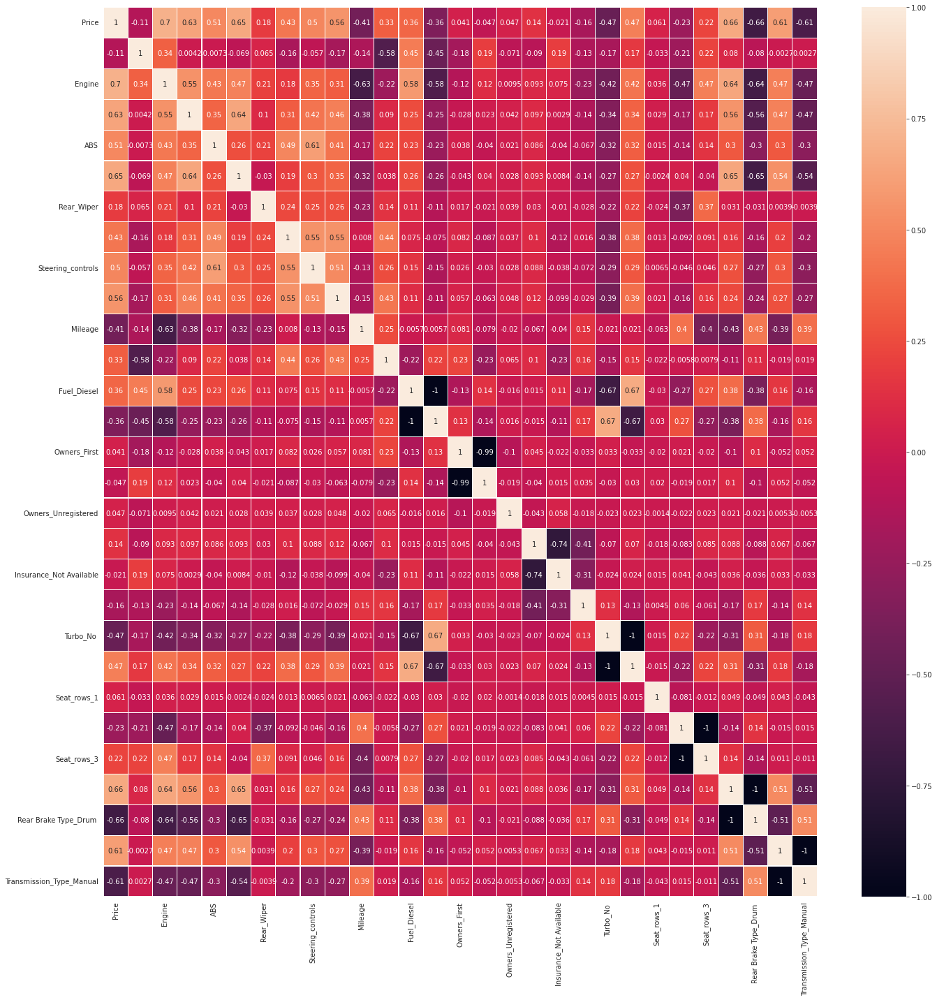

In [60]:
sns.heatmap(df_one_hot.corr(),annot=True,linewidths=0.1)
fig = plt.gcf()
fig.set_size_inches(20,20)
plt.tight_layout()
plt.savefig("corr_matrix_incl_anno_double.png", dpi=300)
plt.show()

# Model Training

In [61]:
from sklearn.linear_model import LinearRegression,Ridge, Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import GradientBoostingRegressor

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score

from sklearn import metrics
from sklearn.metrics import classification_report,ConfusionMatrixDisplay,plot_confusion_matrix, confusion_matrix, precision_score,recall_score,accuracy_score,f1_score

Base Models

In [62]:
X = df_one_hot.iloc[:,1:]
y = df_one_hot.iloc[:,0]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=50)

In [64]:
mae = []
mse = []
rmse = []
r2 = []
adj_r2 = []
model_name = []

def print_metrics(model,y_train,y_test,y_pred_train,y_pred_test):
    model_name.append(model)
    MAE_train = metrics.mean_absolute_error(y_train, y_pred_train)
    MAE_test = metrics.mean_absolute_error(y_test, y_pred_test)
    print('MAE for training set is {}'.format(MAE_train))
    print('MAE for test set is {}'.format(MAE_test))
    mae.append(MAE_test)
    print()
    MSE_train = metrics.mean_squared_error(y_train, y_pred_train)
    MSE_test = metrics.mean_squared_error(y_test, y_pred_test)
    print('MSE for training set is {}'.format(MSE_train))
    print('MSE for test set is {}'.format(MSE_test))
    mse.append(MSE_test)
    print()
    RMSE_train = np.sqrt( metrics.mean_squared_error(y_train, y_pred_train))
    RMSE_test = np.sqrt(metrics.mean_squared_error(y_test, y_pred_test))
    print('RMSE for training set is {}'.format(RMSE_train))
    print('RMSE for test set is {}'.format(RMSE_test))
    rmse.append(RMSE_test)
    print()
    r2_train = metrics.r2_score(y_train,y_pred_train)
    r2_test = metrics.r2_score(y_test,y_pred_test)
    print("R2 score for training set is {}".format(r2_train))
    print("R2 score for test set is {}".format(r2_test))
    r2.append(r2_test)
    print()
    adj_r_squared_train = 1 - (1-r2_train)*(len(y_train)-1)/(len(y_train)-X_train.shape[1]-1)
    adj_r_squared_test = 1 - (1-r2_test)*(len(y_test)-1)/(len(y_test)-X_test.shape[1]-1)
    print("Adjusted R2 score for training set is {}".format(adj_r_squared_train))
    print("Adjusted R2 score for test set is {}".format(adj_r_squared_test))
    adj_r2.append(adj_r_squared_test)
    
def plot_lineplot(y_test,y_pred_test,name):
    plt.figure(figsize=(14,7))
    sns.lineplot(x=pd.DataFrame(y_pred_test).index,y=y_pred_test,legend='brief')
    sns.lineplot(x=pd.DataFrame(y_test).index,y=y_test,legend='brief')
    plt.legend(['Predicted','Actual'],bbox_to_anchor=(1, 0.5),title='Values',title_fontsize=30,loc='center left')
    plt.title('Line Plot of Price : Actual Vs Predicted - '+name,fontdict={'fontsize':25})
    plt.xlabel('ID',fontdict={'fontsize':20})
    plt.ylabel('Price',fontdict={'fontsize':20})
    plt.savefig(name+'.jpg',dpi=300,bbox_inches='tight')
    plt.show()

MAE for training set is 0.20173952177162613
MAE for test set is 0.20648729302240598

MSE for training set is 0.06910145067248946
MSE for test set is 0.07073303226167138

RMSE for training set is 0.2628715478565329
RMSE for test set is 0.2659568240554684

R2 score for training set is 0.8693225012354105
R2 score for test set is 0.8720261607558935

Adjusted R2 score for training set is 0.8684376233719502
Adjusted R2 score for test set is 0.8684853825949893


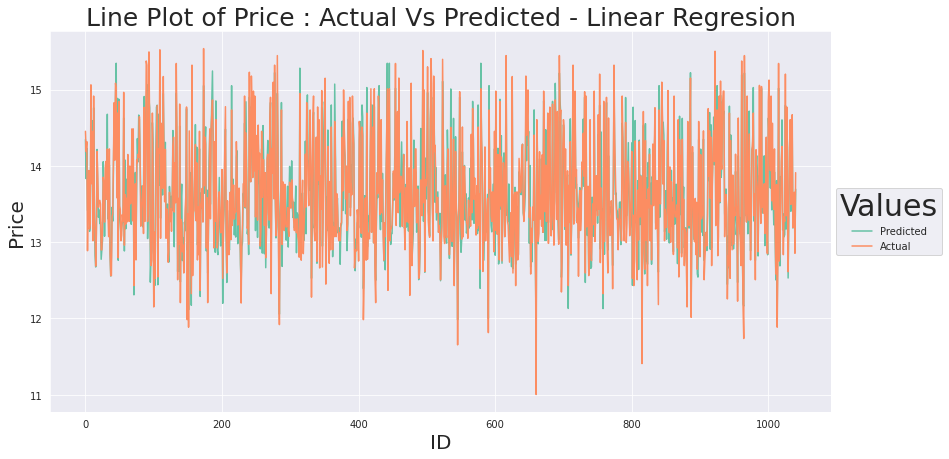

In [65]:
linreg = LinearRegression(n_jobs=-1)
linreg.fit(X_train,y_train)
y_pred_train = linreg.predict(X_train)
y_pred_test = linreg.predict(X_test)
print_metrics('Linear Regresion',y_train,y_test,y_pred_train,y_pred_test)
plot_lineplot(y_test.reset_index(drop=True),y_pred_test,'Linear Regresion')

MAE for training set is 0.24275999198260767
MAE for test set is 0.2484283184296036

MSE for training set is 0.10031597457986345
MSE for test set is 0.10749189709331555

RMSE for training set is 0.31672697166465547
RMSE for test set is 0.3278595691653906

R2 score for training set is 0.8102928300831225
R2 score for test set is 0.8055201322661498

Adjusted R2 score for training set is 0.8090082349784858
Adjusted R2 score for test set is 0.8001392663604702


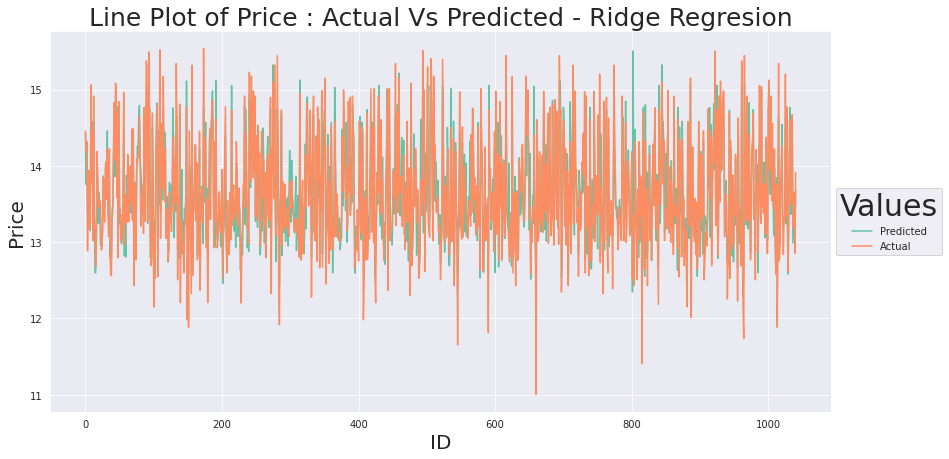

In [66]:
ridge = Ridge()
ridge.fit(X_train,y_train)
y_pred_train = ridge.predict(X_train)
y_pred_test = ridge.predict(X_test)
print_metrics('Linear Regresion',y_train,y_test,y_pred_train,y_pred_test)
plot_lineplot(y_test.reset_index(drop=True),y_pred_test,'Ridge Regresion')

MAE for training set is 0.577309073240665
MAE for test set is 0.5950538143560453

MSE for training set is 0.5287937963747922
MSE for test set is 0.5530067122249754

RMSE for training set is 0.727182092996515
RMSE for test set is 0.7436442107789016

R2 score for training set is 0.0
R2 score for test set is -0.0005281807993369192

Adjusted R2 score for training set is -0.006771463119709775
Adjusted R2 score for test set is -0.028210778687065563


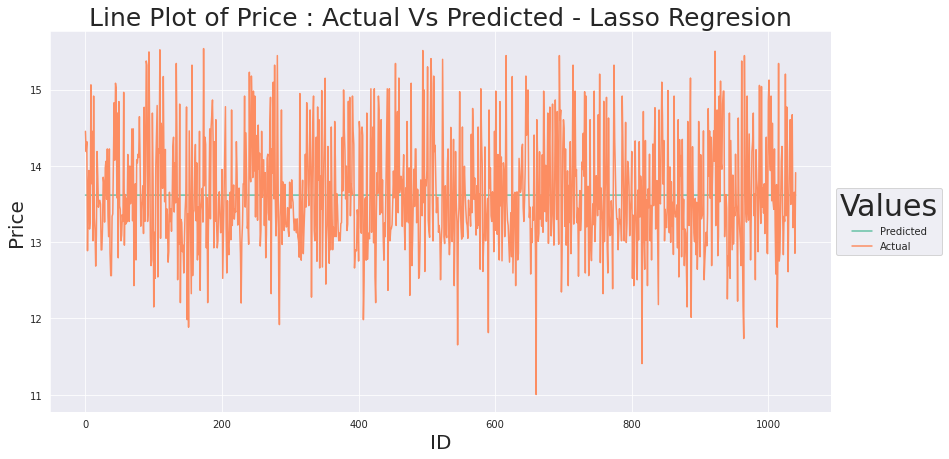

In [67]:
lasso = Lasso()
lasso.fit(X_train,y_train)
y_pred_train = lasso.predict(X_train)
y_pred_test = lasso.predict(X_test)
print_metrics('Linear Regresion',y_train,y_test,y_pred_train,y_pred_test)
plot_lineplot(y_test.reset_index(drop=True),y_pred_test,'Lasso Regresion')

MAE for training set is 0.0002584652349441921
MAE for test set is 0.09305400833953051

MSE for training set is 2.7618148406636713e-05
MSE for test set is 0.0460620679993325

RMSE for training set is 0.005255297175863294
RMSE for test set is 0.21462075388771817

R2 score for training set is 0.9999477714213064
R2 score for test set is 0.9166621379443971

Adjusted R2 score for training set is 0.999947417757412
Adjusted R2 score for test set is 0.9143563472946373


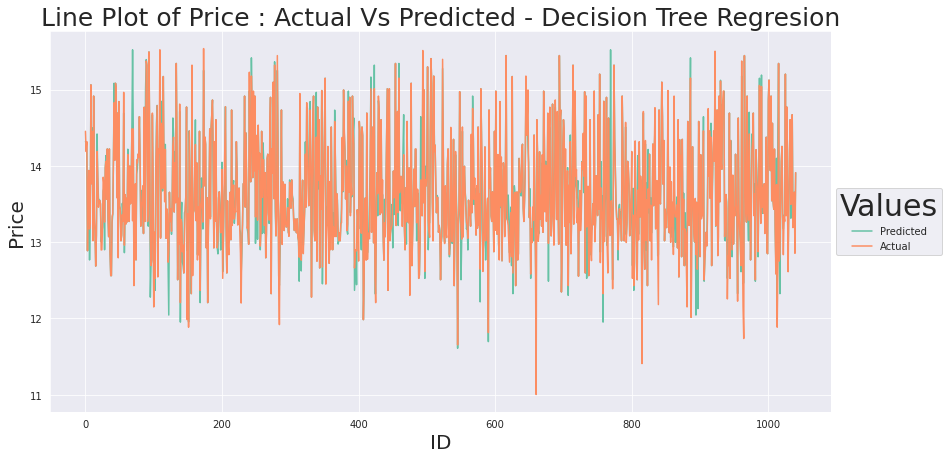

In [68]:
dt = DecisionTreeRegressor()
dt.fit(X_train,y_train)
y_pred_train = dt.predict(X_train)
y_pred_test = dt.predict(X_test)
print_metrics('Linear Regresion',y_train,y_test,y_pred_train,y_pred_test)
plot_lineplot(y_test.reset_index(drop=True),y_pred_test,'Decision Tree Regresion')

MAE for training set is 0.00025846523494417933
MAE for test set is 0.09569494856337929

MSE for training set is 2.7618148406636713e-05
MSE for test set is 0.04862565531780809

RMSE for training set is 0.005255297175863294
RMSE for test set is 0.2205122566158355

R2 score for training set is 0.9999477714213064
R2 score for test set is 0.9120239639414907

Adjusted R2 score for training set is 0.999947417757412
Adjusted R2 score for test set is 0.9095898443667493


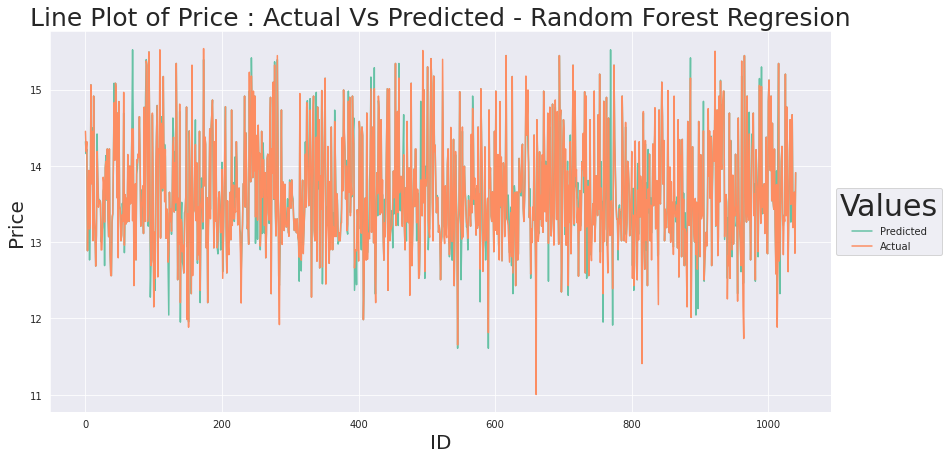

In [69]:
rf = RandomForestRegressor()
dt.fit(X_train,y_train)
y_pred_train = dt.predict(X_train)
y_pred_test = dt.predict(X_test)
print_metrics('Linear Regresion',y_train,y_test,y_pred_train,y_pred_test)
plot_lineplot(y_test.reset_index(drop=True),y_pred_test,'Random Forest Regresion')

MAE for training set is 0.2261186645190293
MAE for test set is 0.2314488068072785

MSE for training set is 0.09238147588969343
MSE for test set is 0.09916726878876972

RMSE for training set is 0.3039432116196929
RMSE for test set is 0.3149083498238332

R2 score for training set is 0.8252977313216883
R2 score for test set is 0.8205814778687499

Adjusted R2 score for training set is 0.8241147413524035
Adjusted R2 score for test set is 0.815617329035079


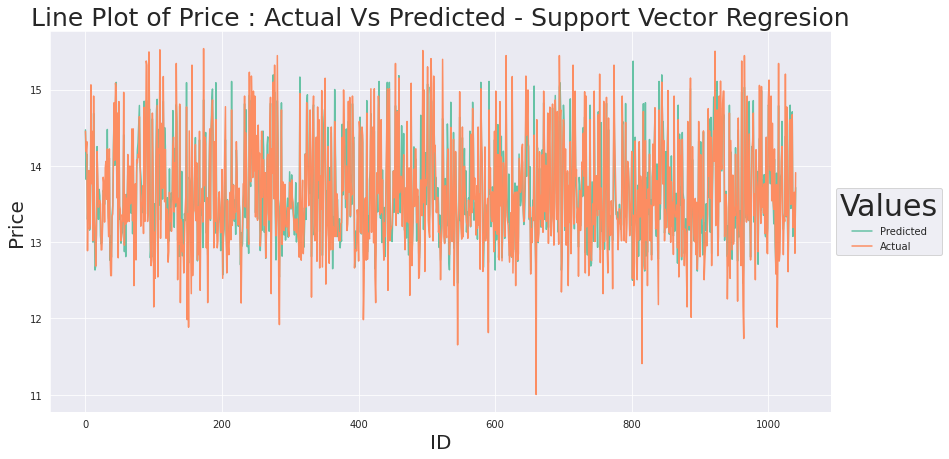

In [70]:
sv = SVR()
sv.fit(X_train,y_train)
y_pred_train = sv.predict(X_train)
y_pred_test = sv.predict(X_test)
print_metrics('Linear Regresion',y_train,y_test,y_pred_train,y_pred_test)
plot_lineplot(y_test.reset_index(drop=True),y_pred_test,'Support Vector Regresion')

MAE for training set is 0.13260924810580524
MAE for test set is 0.1629414291064392

MSE for training set is 0.04434711137356659
MSE for test set is 0.061846239034495785

RMSE for training set is 0.2105875385049329
RMSE for test set is 0.24868904084115928

R2 score for training set is 0.9161353410770069
R2 score for test set is 0.8881046040444961

Adjusted R2 score for training set is 0.9155674546320628
Adjusted R2 score for test set is 0.8850086839982964


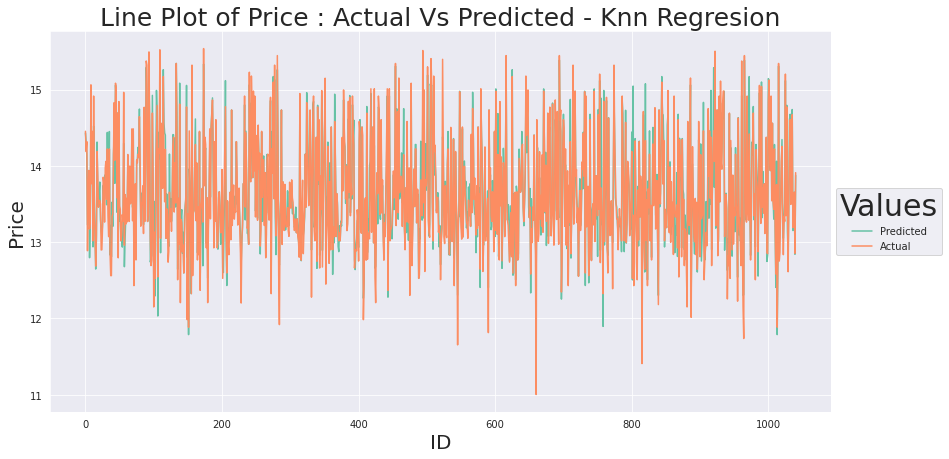

In [71]:
knn = KNeighborsRegressor()
knn.fit(X_train,y_train)
y_pred_train = knn.predict(X_train)
y_pred_test = knn.predict(X_test)
print_metrics('Linear Regresion',y_train,y_test,y_pred_train,y_pred_test)
plot_lineplot(y_test.reset_index(drop=True),y_pred_test,'Knn Regresion')

MAE for training set is 0.14170045081264687
MAE for test set is 0.14629878874425117

MSE for training set is 0.03666370450703126
MSE for test set is 0.04177523648958845

RMSE for training set is 0.1914776867079589
RMSE for test set is 0.20438991288610223

R2 score for training set is 0.9306654034930372
R2 score for test set is 0.9244180939518398

Adjusted R2 score for training set is 0.9301959068298703
Adjusted R2 score for test set is 0.9223268949702702


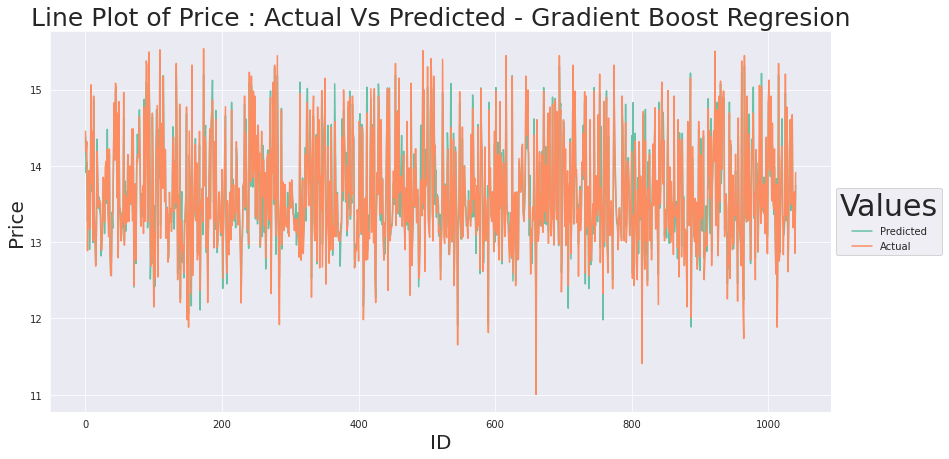

In [72]:
gb = GradientBoostingRegressor()
gb.fit(X_train,y_train)
y_pred_train = gb.predict(X_train)
y_pred_test = gb.predict(X_test)
print_metrics('Linear Regresion',y_train,y_test,y_pred_train,y_pred_test)
plot_lineplot(y_test.reset_index(drop=True),y_pred_test,'Gradient Boost Regresion')

In [73]:
import xgboost as xg

MAE for training set is 4.5787157923737
MAE for test set is 4.575478626838471

MSE for training set is 21.148948673148073
MSE for test set is 21.12749952543873

RMSE for training set is 4.598798611936391
RMSE for test set is 4.596465982190963

R2 score for training set is -38.99469891314378
R2 score for test set is -37.22495857234078

Adjusted R2 score for training set is -39.26552154181803
Adjusted R2 score for test set is -38.28256612177314


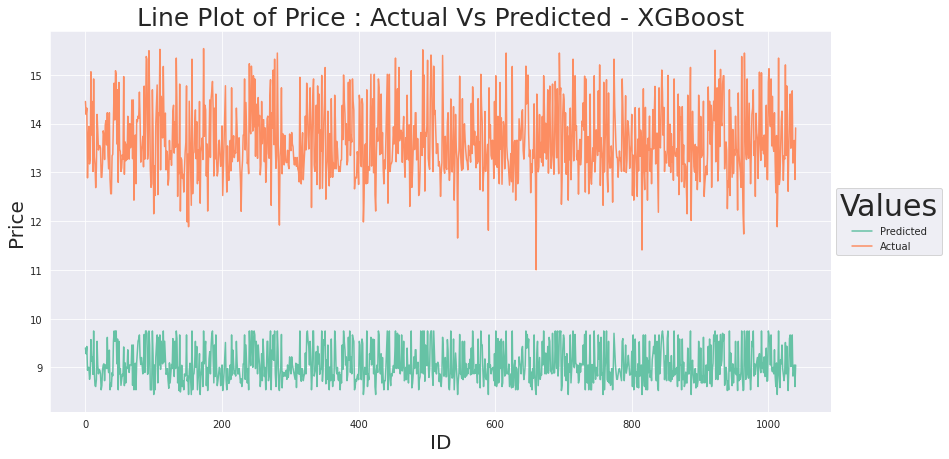

In [74]:
xgb_r = xg.XGBRegressor(objective ='reg:squarederror',
                  n_estimators = 10, seed = 123)
xgb_r.fit(X_train, y_train)
y_pred_train = xgb_r.predict(X_train)
y_pred_test = xgb_r.predict(X_test)
print_metrics('Linear Regresion',y_train,y_test,y_pred_train,y_pred_test)
plot_lineplot(y_test.reset_index(drop=True),y_pred_test,'XGBoost')

# Fine Tune

In [75]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.linear_model import Ridge

parameter_space = {
    "alpha": [0.01,0.1,0.5,1, 10, 100, 290, 500],
    "fit_intercept": [True, False],
    "solver": ['svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga'],
}

clf = GridSearchCV(Ridge(random_state=3), parameter_space, n_jobs=4,
                   cv=3, scoring="neg_root_mean_squared_error")

clf.fit(X_train, y_train)
print("Best parameters:")
print(clf.best_params_)

Best parameters:
{'alpha': 0.01, 'fit_intercept': True, 'solver': 'svd'}


MAE for training set is 0.22585361247496144
MAE for test set is 0.23217612695184559

MSE for training set is 0.08659750288074583
MSE for test set is 0.09219433457641177

RMSE for training set is 0.29427453658233127
RMSE for test set is 0.3036351998310008

R2 score for training set is 0.8362357813680396
R2 score for test set is 0.8331972690121414

Adjusted R2 score for training set is 0.8351268580012452
Adjusted R2 score for test set is 0.8285821736883667


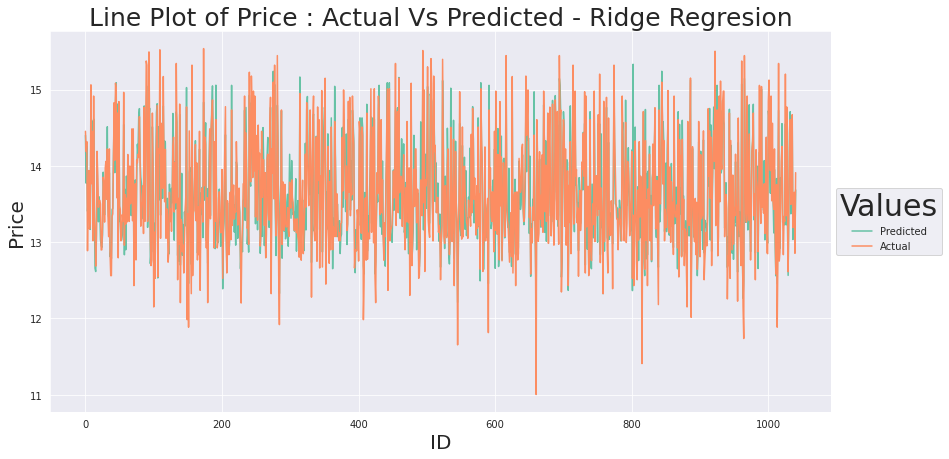

In [76]:
ridge_model = Ridge(random_state=3, **clf.best_params_)
ridge_model.fit(X_train,y_train)
y_pred_train = ridge_model.predict(X_train)
y_pred_test = ridge_model.predict(X_test)
print_metrics('Linear Regresion',y_train,y_test,y_pred_train,y_pred_test)
plot_lineplot(y_test.reset_index(drop=True),y_pred_test,'Ridge Regresion')

In [77]:
parameter_space = {
    "alpha": [0.01,0.1,0.5,1, 10, 100, 290, 500],
    "fit_intercept": [True, False],
    "max_iter":[100,500,1000,1500]
}
clf = GridSearchCV(Lasso(random_state=3), parameter_space, n_jobs=4,
                   cv=3, scoring="neg_root_mean_squared_error")

clf.fit(X_train, y_train)
print("Best parameters:")
print(clf.best_params_)

Best parameters:
{'alpha': 0.01, 'fit_intercept': False, 'max_iter': 1500}


MAE for training set is 0.2561852977345054
MAE for test set is 0.2596942047905519

MSE for training set is 0.11315203286524929
MSE for test set is 0.11590363993937716

RMSE for training set is 0.3363807855173201
RMSE for test set is 0.3404462364887842

R2 score for training set is 0.7860186075536886
R2 score for test set is 0.7903011745553834

Adjusted R2 score for training set is 0.7845696404464342
Adjusted R2 score for test set is 0.7844992307683782


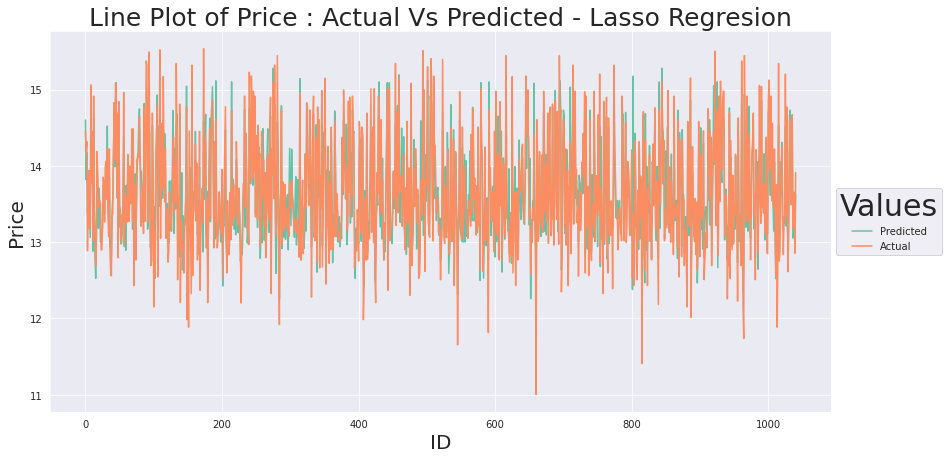

In [78]:
lasso_model = Lasso(random_state=3, **clf.best_params_)
lasso_model.fit(X_train,y_train)
y_pred_train = lasso_model.predict(X_train)
y_pred_test = lasso_model.predict(X_test)
print_metrics('Lasso Regresion',y_train,y_test,y_pred_train,y_pred_test)
plot_lineplot(y_test.reset_index(drop=True),y_pred_test,'Lasso Regresion')

In [79]:
parameter_space = {
    "criterion":['squared_error', 'friedman_mse', 'absolute_error', 'poisson'],
    "max_depth": [None, 10,50,100,200],
    "min_samples_split":[1,2,3],
    "min_samples_leaf":[1,2,3,4],
    "max_features":[None,"auto","sqrt","log2"]
}
clf = GridSearchCV(DecisionTreeRegressor(random_state=3), parameter_space, n_jobs=4,
                   cv=3, scoring="neg_root_mean_squared_error")

clf.fit(X_train, y_train)
print("Best parameters:")
print(clf.best_params_)

Best parameters:
{'criterion': 'friedman_mse', 'max_depth': None, 'max_features': None, 'min_samples_leaf': 2, 'min_samples_split': 2}


MAE for training set is 0.03943028056116513
MAE for test set is 0.10706787801286174

MSE for training set is 0.006031896227288981
MSE for test set is 0.037772613164996784

RMSE for training set is 0.0776652832821009
RMSE for test set is 0.19435177685062924

R2 score for training set is 0.9885931032689087
R2 score for test set is 0.9316598458959817

Adjusted R2 score for training set is 0.9885158618883838
Adjusted R2 score for test set is 0.9297690115927085


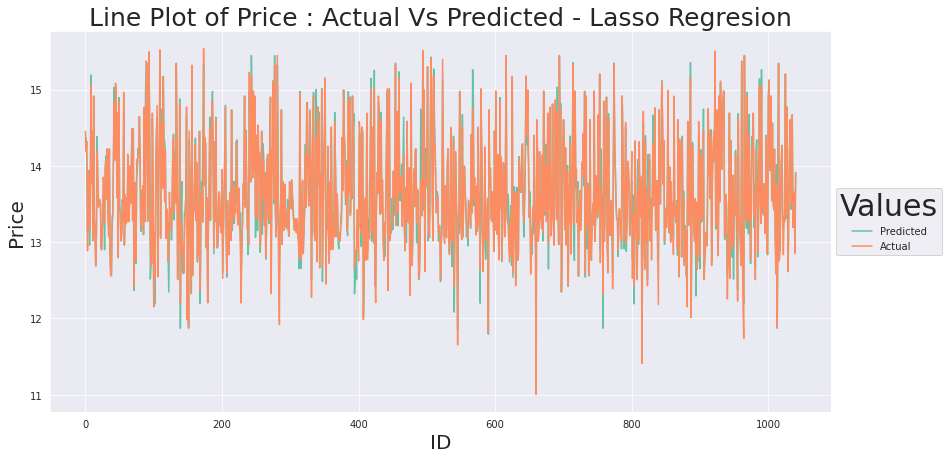

In [80]:
dt_model = DecisionTreeRegressor(random_state=3, **clf.best_params_)
dt_model.fit(X_train,y_train)
y_pred_train = dt_model.predict(X_train)
y_pred_test = dt_model.predict(X_test)
print_metrics('Lasso Regresion',y_train,y_test,y_pred_train,y_pred_test)
plot_lineplot(y_test.reset_index(drop=True),y_pred_test,'Lasso Regresion')

In [81]:
parameter_space = {
    "n_estimators":[20,50,100,150,250,400],
    "criterion": ['squared_error', 'absolute_error','poisson'],
    "max_depth":[None,10,100,150,200],
    "min_samples_split":[1,2,3],
    "min_samples_leaf":[1,2,3,4],
    "max_features":[None,"sqrt","log2",1.0],
    "n_jobs":[-1]
}
clf = RandomizedSearchCV(RandomForestRegressor(random_state=3), parameter_space, n_jobs=4,
                   cv=3, scoring="neg_root_mean_squared_error")

clf.fit(X_train, y_train)
print("Best parameters:")
print(clf.best_params_)

Best parameters:
{'n_jobs': -1, 'n_estimators': 50, 'min_samples_split': 3, 'min_samples_leaf': 4, 'max_features': 1.0, 'max_depth': 150, 'criterion': 'squared_error'}


MAE for training set is 0.07671883967153036
MAE for test set is 0.10401807561774172

MSE for training set is 0.015811138662720502
MSE for test set is 0.02764414235067671

RMSE for training set is 0.12574235031492176
RMSE for test set is 0.16626527704447705

R2 score for training set is 0.9700996139305801
R2 score for test set is 0.9499847961255337

Adjusted R2 score for training set is 0.969897144569046
Adjusted R2 score for test set is 0.9486009762554891


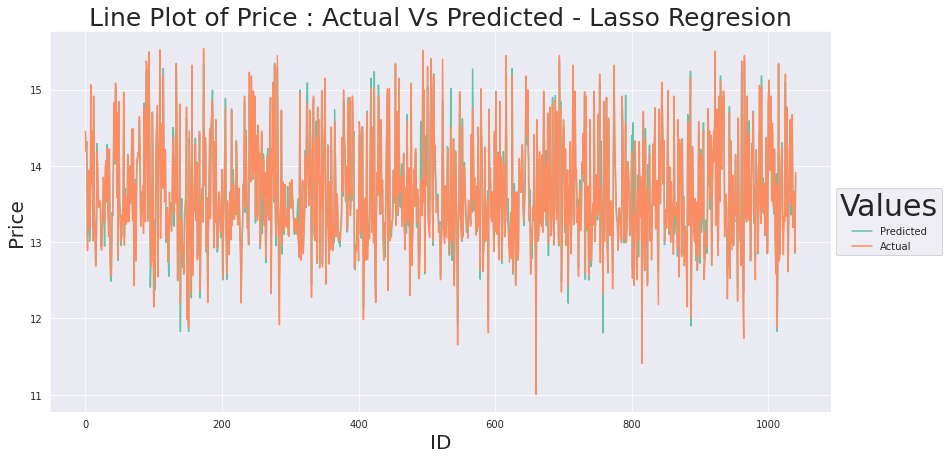

In [82]:
rf_model = RandomForestRegressor(random_state=3, **clf.best_params_)
rf_model.fit(X_train,y_train)
y_pred_train = rf_model.predict(X_train)
y_pred_test = rf_model.predict(X_test)
print_metrics('Lasso Regresion',y_train,y_test,y_pred_train,y_pred_test)
plot_lineplot(y_test.reset_index(drop=True),y_pred_test,'Lasso Regresion')